/var/folders/_t/npypscy96tv6d98v16l4_wlm0000gn/T/ipykernel_931/804506712.py:64: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()


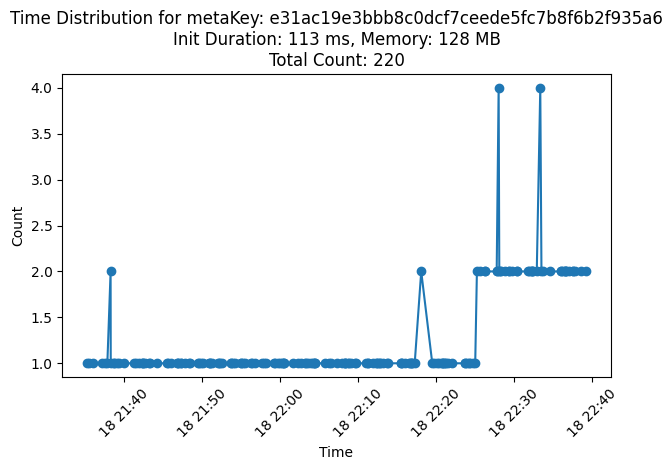

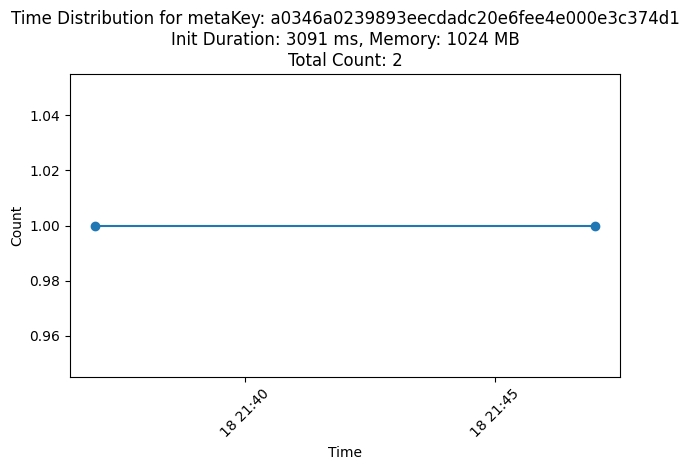

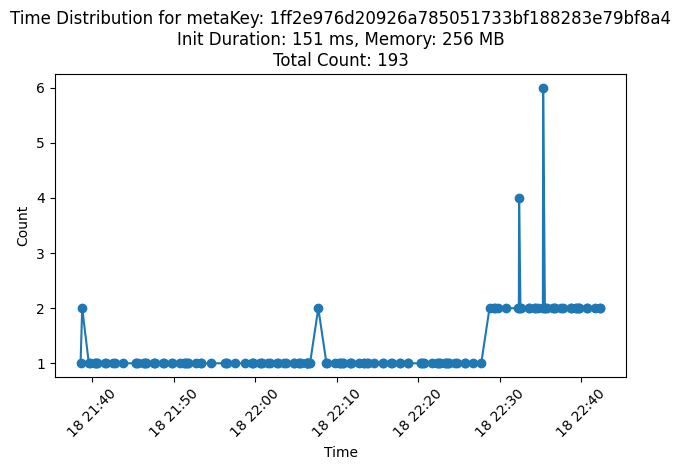

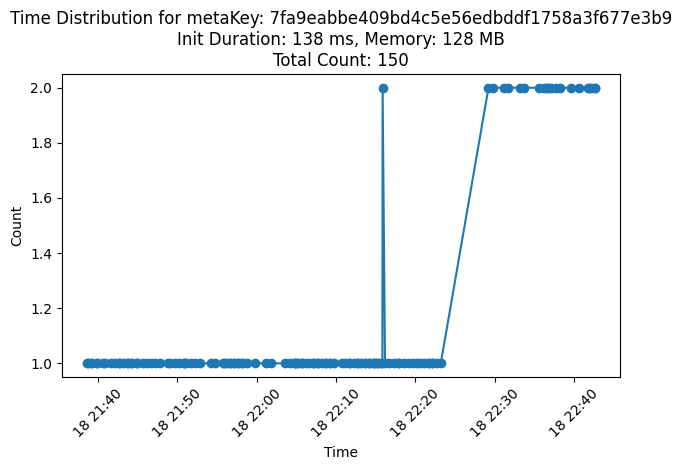

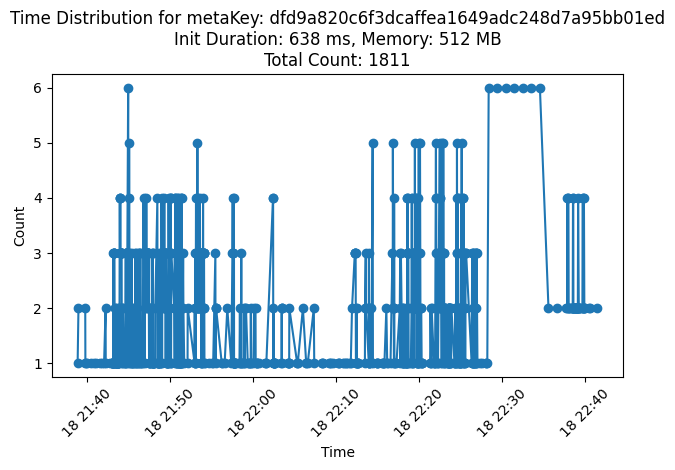

...

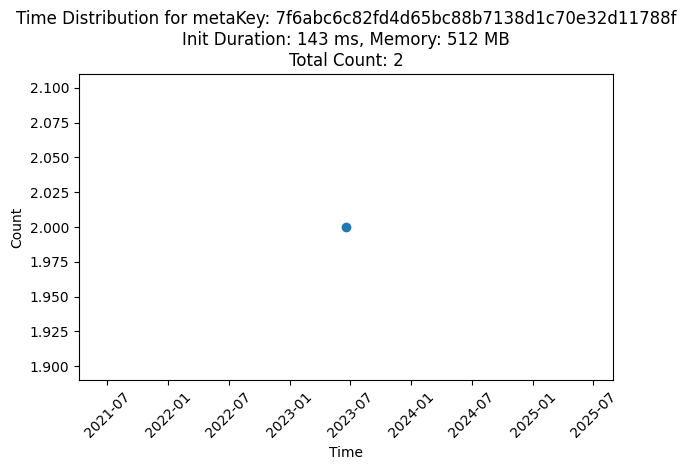

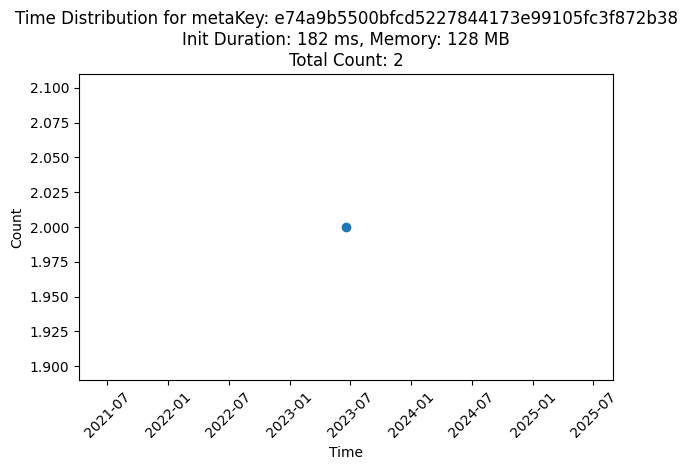

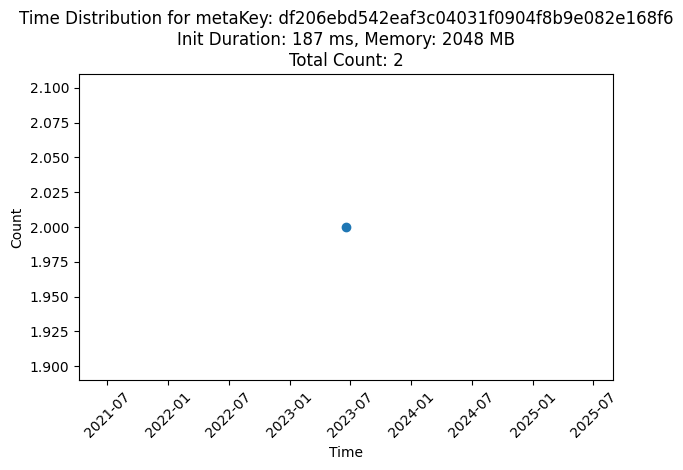

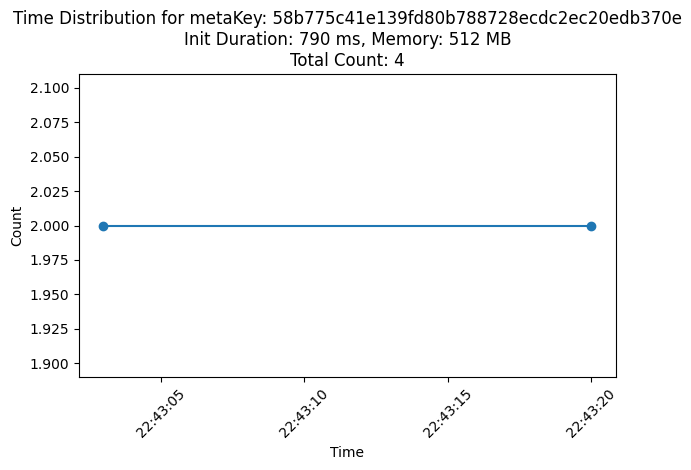

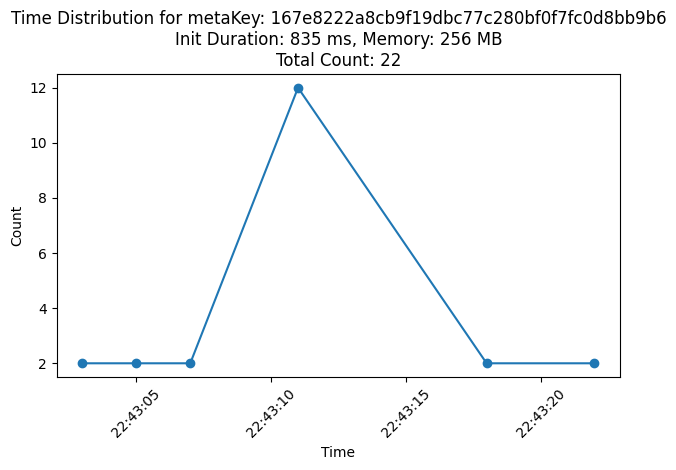

In [6]:
import json
import pandas as pd
import matplotlib.pyplot as plt
from datetime import datetime, timedelta

with open('../data_training/dataSet_3/requests') as f:
    data = f.readlines()

requests = []
for line in data:
    request = json.loads(line)
    requests.append(request)

df = pd.DataFrame(requests)

# Convert startTime to datetime
df["startTime"] = pd.to_datetime(df["startTime"], unit='ms')

# Create a dictionary to store the distribution of different metaKeys
time_distribution = {}
key_cnt_total = {}
for _, entry in df.iterrows():
    meta_key = entry["metaKey"]
    start_time = entry["startTime"]
    
    if meta_key not in time_distribution:
        time_distribution[meta_key] = {}
        key_cnt_total[meta_key] = 0
    
    # Convert start_time to seconds and round to the nearest second
    start_time_seconds = round(start_time.timestamp())
    
    if start_time_seconds not in time_distribution[meta_key]:
        time_distribution[meta_key][start_time_seconds] = 0
    
    time_distribution[meta_key][start_time_seconds] += 1
    key_cnt_total[meta_key] += 1

# Read metas data
with open('../data_training/dataSet_3/metas') as f:
    metas_data = f.readlines()

metas = []
for line in metas_data:
    meta = json.loads(line)
    metas.append(meta)

metas_df = pd.DataFrame(metas)

metaMap = {}
for _, entry in metas_df.iterrows():
    meta_key = entry["key"]
    init_duration = entry["initDurationInMs"]
    memory = entry["memoryInMb"]
    metaMap[meta_key] = {"initDurationInMs": init_duration, "memoryInMb": memory}

# Plot the time distribution for each metaKey as line plots
for meta_key, distribution in time_distribution.items():
    time_counts = sorted(distribution.items())
    start_time_seconds, counts = zip(*time_counts)
    init_duration = metaMap[meta_key]["initDurationInMs"]
    memory = metaMap[meta_key]["memoryInMb"] 
    total_cnt = key_cnt_total[meta_key]
    if total_cnt > 1000:
        plt.figure()
        plt.plot(pd.to_datetime(start_time_seconds, unit='s'), counts, marker='o')  # Convert start_time_seconds to datetime
        plt.xlabel('Time')
        plt.ylabel('Count')
        plt.title(f'Time Distribution for metaKey: {meta_key}\nInit Duration: {init_duration} ms, Memory: {memory} MB\nTotal Count: {total_cnt}')
        plt.xticks(rotation=45)
        plt.tight_layout()

plt.show()
